#### IMPORTS

In [1]:
from utils.kernel import RBFKernel, LinearKernel, Matern52Kernel
from utils.gaussian_process import GaussianProcess as GP
import numpy as np
import pandas as pd
import scanpy as sc
import os
import scvelo as scv
import matplotlib.pyplot as plt
import random
random.seed(1997)
np.random.seed(1997)

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)

scanpy==1.4.5.post2 anndata==0.6.22.post1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==0.24.2 scikit-learn==0.22.1 statsmodels==0.11.0rc1 python-igraph==0.7.1 louvain==0.6.1


## Load Dataset

In [3]:
filename = "tgfb1-3-" + "treated" + ".h5ad"
filename = os.path.join("write", filename)
anndata = sc.read_h5ad(filename)

### Dimensionality reductions

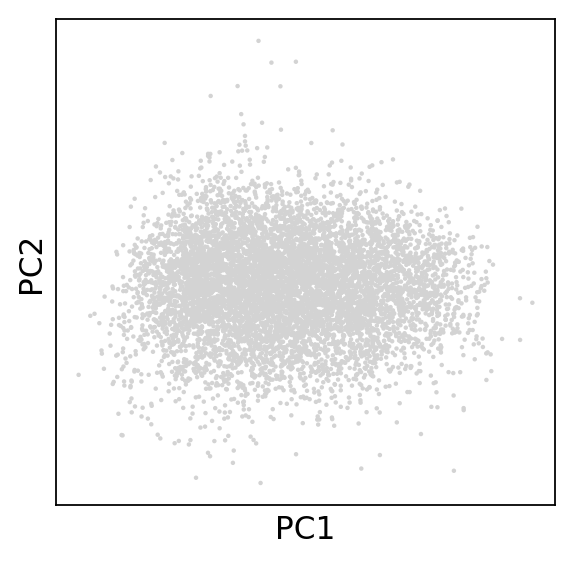

In [4]:
sc.pl.pca(anndata)

TGFB1 present in treated batch :  True
Printing TGFB1 PCA plot for treated batch


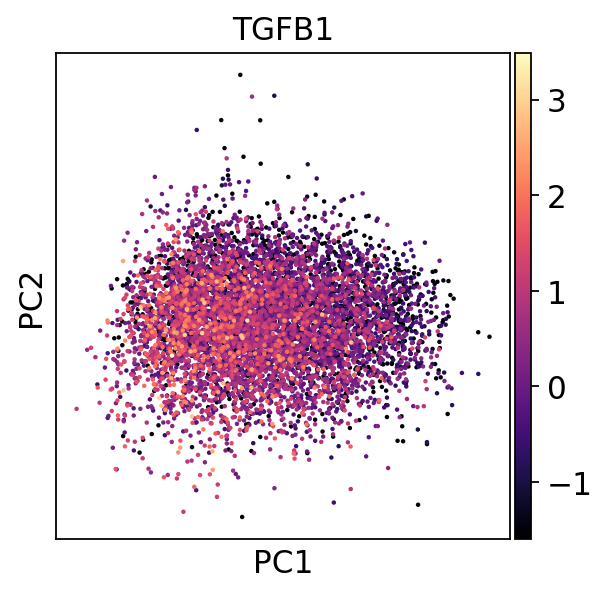

In [5]:
present = any(anndata.var.gene_names == "TGFB1")
print("TGFB1 present in treated batch", ": ", present)

if present:
    print("Printing TGFB1 PCA plot for treated batch")
    sc.pl.pca(anndata, color="TGFB1", color_map='magma')

In [6]:
print("Neighborhood graph calculation for treated batch")
sc.pp.neighbors(anndata, n_neighbors=10, n_pcs=40)

Neighborhood graph calculation for treated batch
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:02)


In [7]:
print("UMAP calculations for treated batch")
sc.tl.umap(anndata)

UMAP calculations for treated batch
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)


In [8]:
scv.tl.velocity(anndata, mode='stochastic')
scv.tl.velocity_graph(anndata)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:01) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:21) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [9]:
scv.tl.velocity_embedding(anndata, basis='umap')

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


In [10]:
sc.tl.louvain(anndata)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 7 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:01)


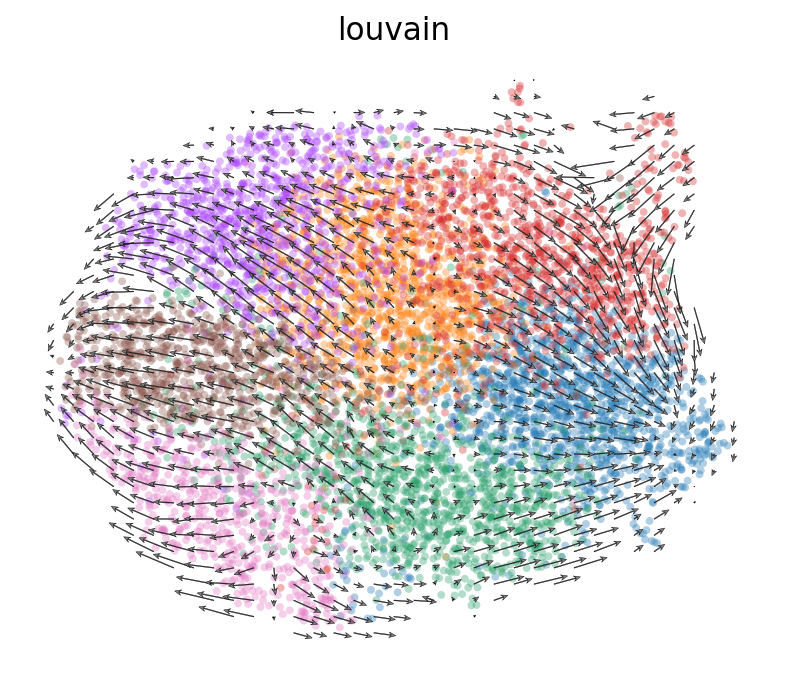

In [11]:
scv.pl.velocity_embedding_grid(anndata, basis='umap', figsize=(6, 5),
                               arrow_length=4.5, density=0.7, size=50,
                               arrow_size=1.5, alpha=0.35, 
#                                vmin=-1, vmax=1, color="SERPINE1", color_map="bwr"
                              )

### Look at Top Velocity Genes

In [12]:
scv.tl.rank_velocity_genes(anndata, match_with='clusters', resolution=.4)

computing velocity clusters
    finished (0:00:02) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns)


In [13]:
pd.DataFrame(anndata.uns['rank_velocity_genes']['names'])

,0,1,2,3,4,5
0,CALD1,SPOCK1,EXT1,PKM,ITGA2,GXYLT2
1,ITGBL1,VCAN,NTM,RGS17,TPST1,SERPINE1
2,CRIM1,WWTR1,ITGA11,TPST1,ANKH,FEM1B
3,SERPINE2,PSD3,FAM129A,PTGR1,WWTR1,CYTL1
4,DDAH1,MCC,TGFBR2,MCUB,NRP1,NFIB
5,TPM1,ZNF521,AFAP1,DPYSL3,COL15A1,FST
6,CCDC80,SYNJ2,GPR176,APCDD1L,SLC22A3,RBMS3
7,MARCH4,LINC00511,TXNRD1,PRRX1,HS3ST3A1,SERPINE2
8,CDH2,FAM168A,CCDC80,PLXNA4,NAMPT,CALD1
9,MSRB3,JARID2,FEM1B,AKR1C1,TPM1,COL5A1


## Look at the spread of the data and the # of zero counts

Counts:  33804463
0s counts:  0
non 0s counts:  33804463
Sum:  0.046585083
Mean:  1.3780749e-09
Std:  0.9999319
Max:  22.857864
Min:  -12.238169



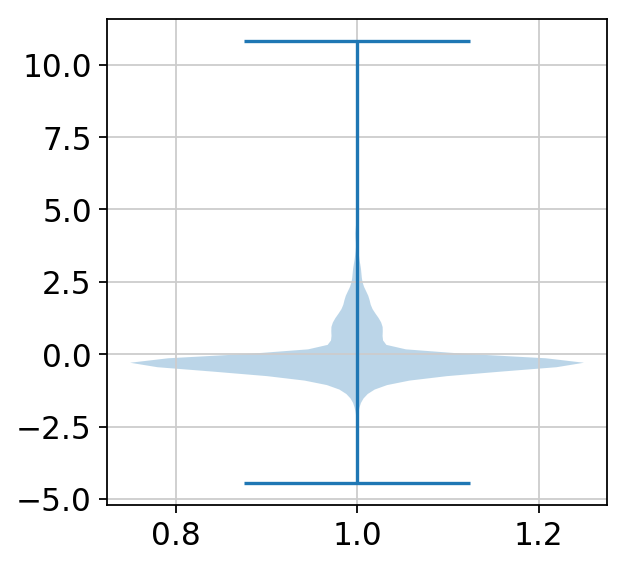

In [14]:
# statistics
data = anndata.X
print("Counts: ", data.shape[0] * data.shape[1])
print("0s counts: ", np.sum(data == 0.0)) 
print("non 0s counts: ", np.sum(data != 0.0))
print("Sum: ", np.sum(data[data != 0.0]))
print("Mean: ", np.mean(data[data != 0.0])) 
print("Std: ", np.std(data[data != 0.0]))
print("Max: ", np.max(data))
print("Min: ", np.min(data))
random_data = np.random.choice(np.ravel(data), 5000)
plt.violinplot(random_data)
print()

Mean:  -0.00968814749810369
Std:  1.0167798205613285
Max:  10.812930107786325
Min:  -4.462152950257337


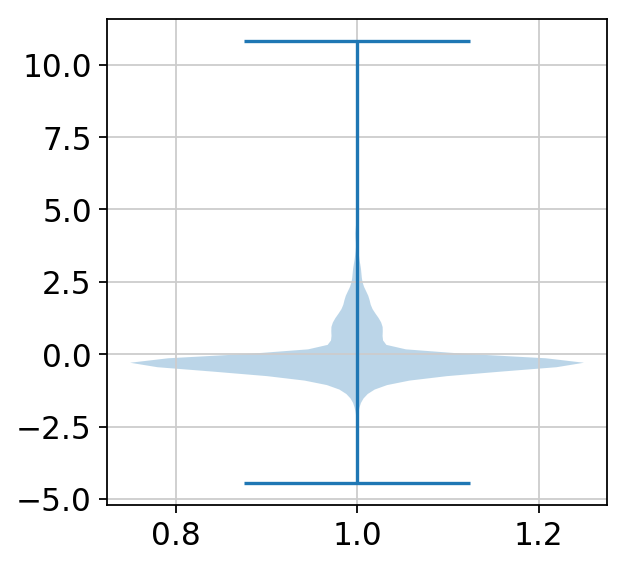

In [15]:
noiseless = random_data - np.random.randn(5000)*1e-8
plt.violinplot(noiseless)
print("Mean: ", np.mean(noiseless))
print("Std: ", np.std(noiseless))
print("Max: ", np.max(noiseless))
print("Min: ", np.min(noiseless))

In [16]:
def loss(true, pred, penalize_0s=True):
    error = np.square(true - pred)
    if not penalize_0s:
        error =  error[true != 0]
    return np.sqrt(np.mean(error))

# Baseline Gassian Process

    1. Using the RBF (Squared Exponent) Kernel
    2. 40% of dataset
    3. Optimize only for first gene in list

In [17]:
genes = {gene:i for i, gene in enumerate(list(anndata.var["velocity_genes"].index)) if anndata.var["velocity_genes"][gene]}
GENES = list(genes.keys())

In [18]:
kernel = RBFKernel(alpha=0.1, gamma=1)
gp = GP(kernel=kernel, optimize=True, restarts=0, alpha=1e-10)

In [19]:
mse_errors = []
X = anndata.obsm["X_umap"][:, :2]

In [20]:
#### Optimize for random gene
random_gene = np.random.choice(GENES)
print(random_gene)
y = anndata.X[:, genes[random_gene]].reshape(-1)
Y = y
gp.fit(X, Y.reshape(-1, 1), sample_ratio=0.4)
kernel.gamma

SYNE1


array([1., 1.])

In [21]:
#### Fit On All Genes
for gene in GENES:
    y = anndata.X[:, genes[gene]].reshape(-1)
    Y = y
    gp.fit(X, Y.reshape(-1, 1), sample_ratio=0.4)
    gp.log_marginal_likelihood(gene, info=True)
    pred = gp.predict(X)
    mse_errors.append(np.sqrt(np.sum((y - pred)**2)/X.shape[0]))

Gene: A4GALT       Marginal Likelihood: [-4242.35337849]
Gene: ABCA1        Marginal Likelihood: [-4207.99688791]
Gene: ABCC3        Marginal Likelihood: [-4300.07074066]
Gene: ABHD2        Marginal Likelihood: [-4154.08238845]
Gene: ABI3BP       Marginal Likelihood: [-4309.24353704]
Gene: AC003092.1   Marginal Likelihood: [-4052.79251424]
Gene: AC083967.1   Marginal Likelihood: [-4424.7676375]
Gene: AC097478.1   Marginal Likelihood: [-4179.56004839]
Gene: AC105999.2   Marginal Likelihood: [-4289.40649385]
Gene: ACVR2A       Marginal Likelihood: [-4167.78457036]
Gene: ADAM12       Marginal Likelihood: [-4152.82161866]
Gene: ADAMTS10     Marginal Likelihood: [-4300.24247527]
Gene: ADAMTS12     Marginal Likelihood: [-4248.60707275]
Gene: ADD3         Marginal Likelihood: [-4243.28128442]
Gene: ADGRL4       Marginal Likelihood: [-4246.39932493]
Gene: ADTRP        Marginal Likelihood: [-4329.72698118]
Gene: AFAP1        Marginal Likelihood: [-3882.93594274]
Gene: AKAP12       Marginal Like

Gene: GCLM         Marginal Likelihood: [-4337.7624371]
Gene: GEM          Marginal Likelihood: [-4357.09859229]
Gene: GFPT1        Marginal Likelihood: [-4195.45013412]
Gene: GFPT2        Marginal Likelihood: [-4263.59034325]
Gene: GLDN         Marginal Likelihood: [-4293.79524897]
Gene: GLS          Marginal Likelihood: [-3855.75052656]
Gene: GMPR         Marginal Likelihood: [-4202.25600027]
Gene: GPAM         Marginal Likelihood: [-4235.9233689]
Gene: GPAT3        Marginal Likelihood: [-4121.15179542]
Gene: GPC6         Marginal Likelihood: [-4049.01288265]
Gene: GPR1         Marginal Likelihood: [-4024.45251898]
Gene: GPR176       Marginal Likelihood: [-4147.54941312]
Gene: GPR68        Marginal Likelihood: [-4239.41010063]
Gene: GRAMD2B      Marginal Likelihood: [-4108.7625375]
Gene: GRB14        Marginal Likelihood: [-4369.45753034]
Gene: GREM1        Marginal Likelihood: [-4162.15880055]
Gene: GRIA3        Marginal Likelihood: [-4178.69821655]
Gene: GULP1        Marginal Likeli

Gene: PMEPA1       Marginal Likelihood: [-4102.3568008]
Gene: PMP22        Marginal Likelihood: [-4313.62290011]
Gene: POSTN        Marginal Likelihood: [-4350.47439892]
Gene: PPFIBP1      Marginal Likelihood: [-4233.22663065]
Gene: PPP1R14C     Marginal Likelihood: [-4285.83548459]
Gene: PQLC2L       Marginal Likelihood: [-4358.96635844]
Gene: PRG4         Marginal Likelihood: [-4360.59029736]
Gene: PRICKLE1     Marginal Likelihood: [-4297.87386716]
Gene: PRR16        Marginal Likelihood: [-4190.49996466]
Gene: PRR5L        Marginal Likelihood: [-4238.73208361]
Gene: PRRX1        Marginal Likelihood: [-4094.19705055]
Gene: PRSS23       Marginal Likelihood: [-4243.04001603]
Gene: PRSS3        Marginal Likelihood: [-4147.27570315]
Gene: PSD3         Marginal Likelihood: [-3862.4670479]
Gene: PTGIS        Marginal Likelihood: [-4318.94210848]
Gene: PTGR1        Marginal Likelihood: [-4264.10255001]
Gene: PTGS1        Marginal Likelihood: [-4245.58715942]
Gene: PTK2         Marginal Likel

### Rank Genes by Smoothness

Get top and last 10 genes by smoothness

In [22]:
lh = gp.get_all_likelihoods()
top = list(zip(*sorted(list(lh.items()), key=lambda x:x[1], reverse=True)))[0]
last = top[::-1]
top[:10]

('CALD1',
 'TNFRSF11B',
 'SERPINE1',
 'CCDC80',
 'PXDC1',
 'DDAH1',
 'WWTR1',
 'EXT1',
 'FGF2',
 'DLC1')

In [23]:
last[:10]

('KLHL4',
 'LDLRAD4',
 'RAB27B',
 'LINC01139',
 'DNM1',
 'SEPT6',
 'KRT8',
 'DEPTOR',
 'AC083967.1',
 'RTKN2')

### Inspect Corelation Between Genes

Plot the correlation between top 3:

    1. smoothest and least smooth genes
    2. smoothest and smoothest genes
    3. lest smooth and leat smooth genes

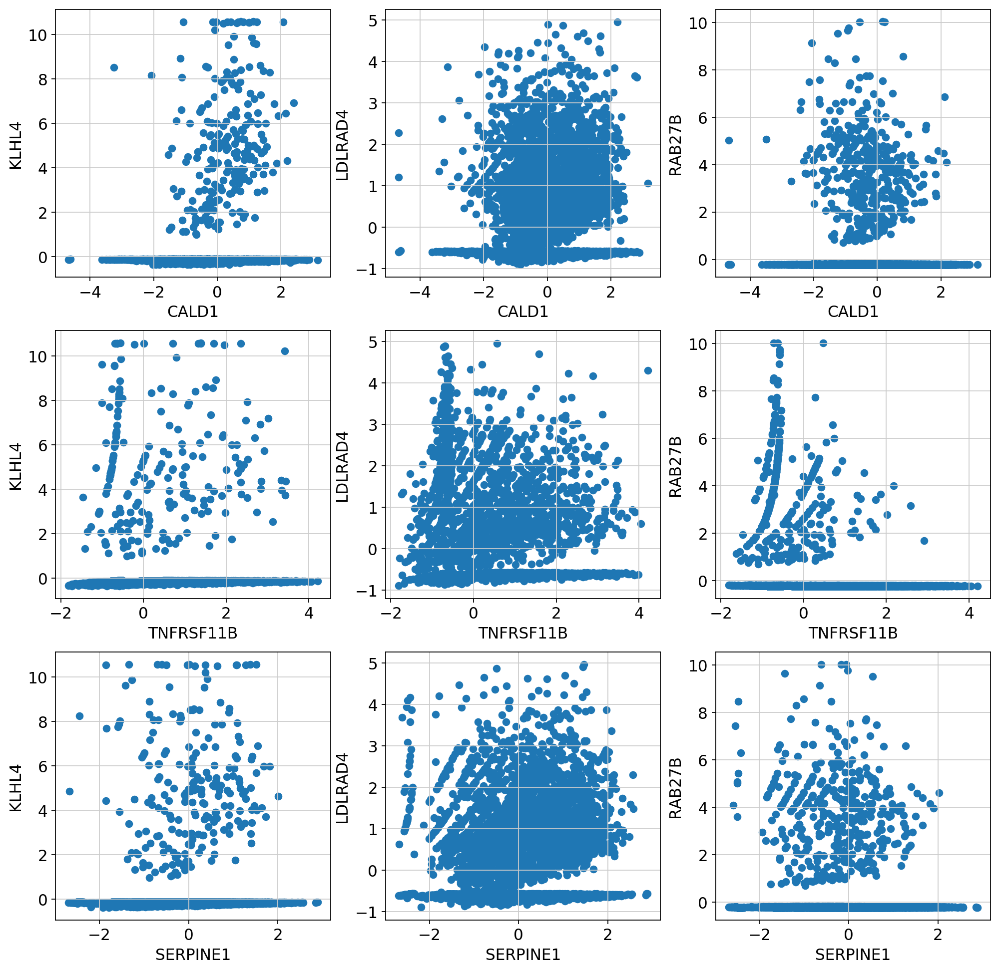

In [24]:
fig, ax = plt.subplots(3, 3, figsize=(15, 15))
for i, genei in enumerate(top[:3]):
    for j, genej in enumerate(last[:3]):
        ax[i][j].scatter(anndata.X[:, genes[genei]], anndata.X[:, genes[genej]])
#         ax[i][j].set_title("Correlation between {} and {}".format(genei, genej))
        ax[i][j].set_xlabel(genei)
        ax[i][j].set_ylabel(genej)

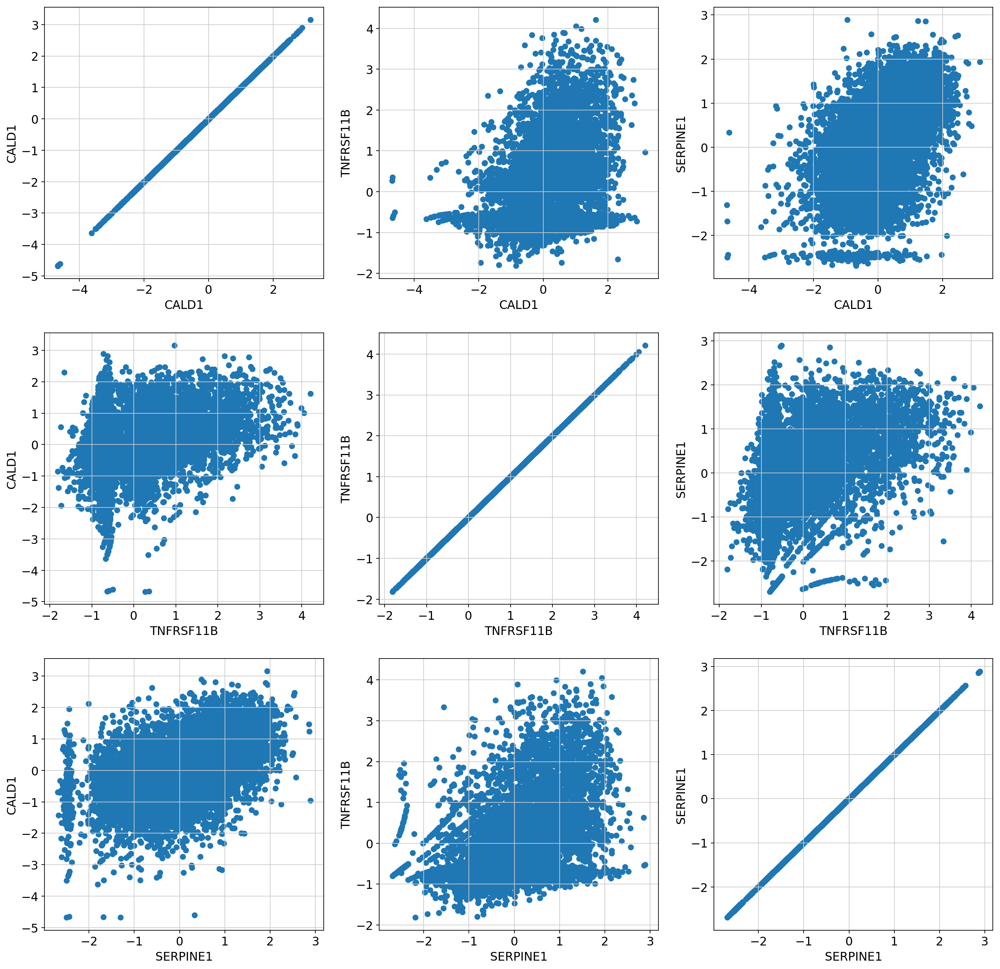

In [25]:
fig, ax = plt.subplots(3, 3, figsize=(20, 20))
for i, genei in enumerate(top[:3]):
    for j, genej in enumerate(top[:3]):
        ax[i][j].scatter(anndata.X[:, genes[genei]], anndata.X[:, genes[genej]])
#         ax[i][j].set_title("Correlation between {} and {}".format(genei, genej))
        ax[i][j].set_xlabel(genei)
        ax[i][j].set_ylabel(genej)

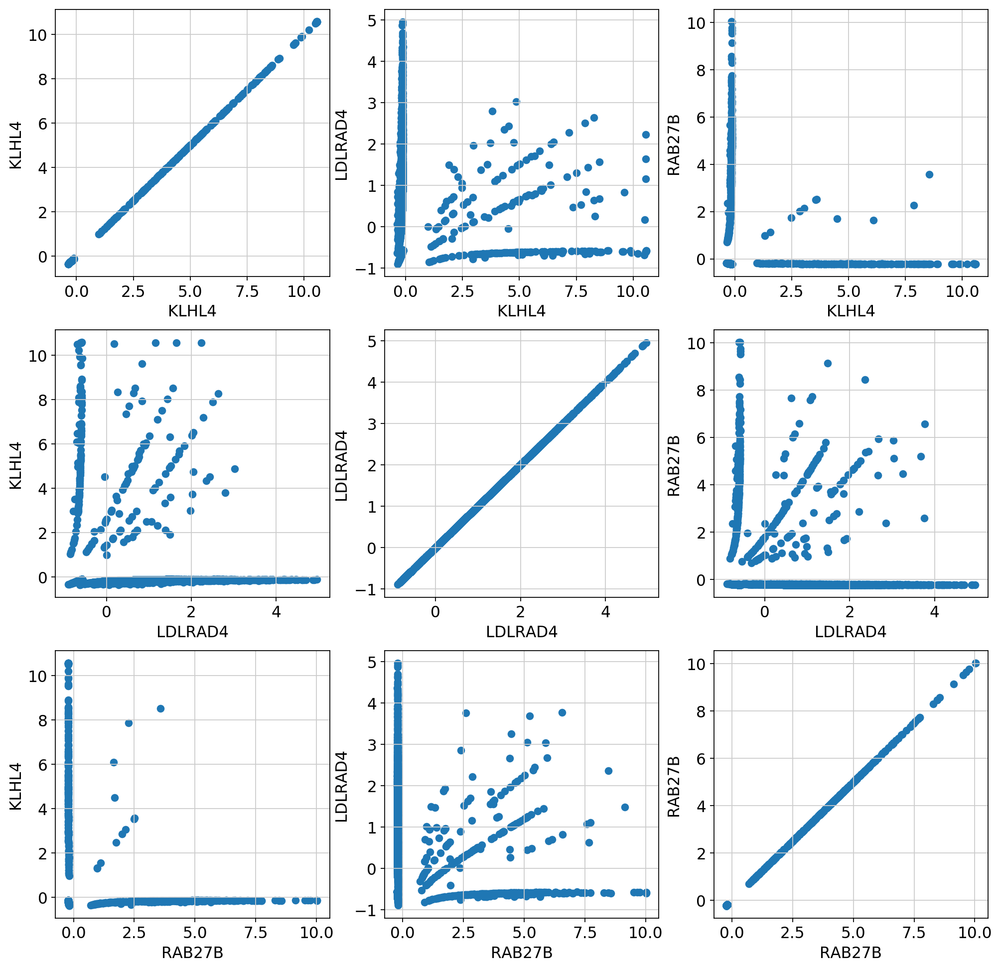

In [26]:
fig, ax = plt.subplots(3, 3, figsize=(15, 15))
for i, genei in enumerate(last[:3]):
    for j, genej in enumerate(last[:3]):
        ax[i][j].scatter(anndata.X[:, genes[genei]], anndata.X[:, genes[genej]])
#         ax[i][j].set_title("Correlation between {} and {}".format(genei, genej))
        ax[i][j].set_xlabel(genei)
        ax[i][j].set_ylabel(genej)

## Gaussian Process with RNA Velocity Observations

Enhance the model by adding RNA Velocities

    1. Use only 20% of the dataset

In [27]:
kernel_do = RBFKernel(alpha=0.1, gamma=1)
gp_do = GP(kernel=kernel_do, derivative_observations=True, optimize=False, restarts=0, alpha=1e-10)

In [28]:
errors_do = []
X = anndata.obsm["X_umap"][:, :2]
dy_x1 = anndata.obsm["velocity_umap"][:, 0]
dy_x2 = anndata.obsm["velocity_umap"][:, 1]

In [29]:
#### Use the same gammas as in the baseline model
gp_do.gamma = gp.kernel.gamma

In [30]:
for gene in GENES:
    y = anndata.X[:, genes[gene]].reshape(-1)
    Y = np.hstack((y, dy_x1, dy_x2))
    gp_do.fit(X, Y.reshape(-1, 1), sample_ratio=0.2)
    gp_do.log_marginal_likelihood(gene, info=True)
    pred = gp_do.predict(X)
    errors_do.append(np.sqrt(np.sum((y - pred)**2)/X.shape[0]))

Gene: A4GALT       Marginal Likelihood: [-2131.01144945]
Gene: ABCA1        Marginal Likelihood: [-2128.87149349]
Gene: ABCC3        Marginal Likelihood: [-2125.34847603]
Gene: ABHD2        Marginal Likelihood: [-2066.66439027]
Gene: ABI3BP       Marginal Likelihood: [-2203.05024608]
Gene: AC003092.1   Marginal Likelihood: [-2107.84495666]
Gene: AC083967.1   Marginal Likelihood: [-2130.81870614]
Gene: AC097478.1   Marginal Likelihood: [-2013.13461206]
Gene: AC105999.2   Marginal Likelihood: [-2143.57764651]
Gene: ACVR2A       Marginal Likelihood: [-2114.77095496]
Gene: ADAM12       Marginal Likelihood: [-2097.37747423]
Gene: ADAMTS10     Marginal Likelihood: [-2156.44525467]
Gene: ADAMTS12     Marginal Likelihood: [-2164.75681236]
Gene: ADD3         Marginal Likelihood: [-2092.31553434]
Gene: ADGRL4       Marginal Likelihood: [-2115.41167355]
Gene: ADTRP        Marginal Likelihood: [-2121.13288613]
Gene: AFAP1        Marginal Likelihood: [-1966.43150343]
Gene: AKAP12       Marginal Lik

Gene: GCLM         Marginal Likelihood: [-2159.50860542]
Gene: GEM          Marginal Likelihood: [-2109.18144532]
Gene: GFPT1        Marginal Likelihood: [-2081.12027797]
Gene: GFPT2        Marginal Likelihood: [-2125.07837151]
Gene: GLDN         Marginal Likelihood: [-2174.30417374]
Gene: GLS          Marginal Likelihood: [-1957.69175908]
Gene: GMPR         Marginal Likelihood: [-2163.87345012]
Gene: GPAM         Marginal Likelihood: [-2082.28431649]
Gene: GPAT3        Marginal Likelihood: [-2080.74277847]
Gene: GPC6         Marginal Likelihood: [-1997.98350217]
Gene: GPR1         Marginal Likelihood: [-2023.25133317]
Gene: GPR176       Marginal Likelihood: [-2103.66988296]
Gene: GPR68        Marginal Likelihood: [-2118.16943235]
Gene: GRAMD2B      Marginal Likelihood: [-2161.75654049]
Gene: GRB14        Marginal Likelihood: [-2136.84579295]
Gene: GREM1        Marginal Likelihood: [-2049.616578]
Gene: GRIA3        Marginal Likelihood: [-2081.98612452]
Gene: GULP1        Marginal Likel

Gene: PLXNA4       Marginal Likelihood: [-2076.29485641]
Gene: PMEPA1       Marginal Likelihood: [-2020.15807377]
Gene: PMP22        Marginal Likelihood: [-2132.10852364]
Gene: POSTN        Marginal Likelihood: [-2136.2283806]
Gene: PPFIBP1      Marginal Likelihood: [-2132.99460648]
Gene: PPP1R14C     Marginal Likelihood: [-2147.30318595]
Gene: PQLC2L       Marginal Likelihood: [-2147.81563866]
Gene: PRG4         Marginal Likelihood: [-2236.11966327]
Gene: PRICKLE1     Marginal Likelihood: [-2156.07702347]
Gene: PRR16        Marginal Likelihood: [-2095.95567171]
Gene: PRR5L        Marginal Likelihood: [-2130.37201665]
Gene: PRRX1        Marginal Likelihood: [-2051.85788024]
Gene: PRSS23       Marginal Likelihood: [-2093.39295229]
Gene: PRSS3        Marginal Likelihood: [-2068.4871679]
Gene: PSD3         Marginal Likelihood: [-1987.70188605]
Gene: PTGIS        Marginal Likelihood: [-2118.71341573]
Gene: PTGR1        Marginal Likelihood: [-2135.53085097]
Gene: PTGS1        Marginal Likel

In [31]:
lh_do = gp_do.get_all_likelihoods()
top_do = list(zip(*sorted(list(lh_do.items()), key=lambda x:x[1], reverse=True)))[0]
last_do = top_do[::-1]
top_do[:10]

('CALD1',
 'SERPINE1',
 'DDAH1',
 'TNFRSF11B',
 'CCDC80',
 'FGF2',
 'PXDC1',
 'FST',
 'DLC1',
 'EXT1')

In [32]:
last_do[:10]

('SEMA3D',
 'AL355607.2',
 'VIPR1',
 'LINC01239',
 'HAPLN1',
 'DRAXIN',
 'PKIB',
 'EDN1',
 'PRG4',
 'SNTB1')

## Gaussian Process with RBF + Linear Kernel

    1. Use 40% of the data

Check how RBF + Linear Kernel compares to the one with RNA Velocity observations

In [33]:
kernel_combined = RBFKernel(alpha=0.1, gamma=1) + LinearKernel(scale=0.1, sigma=0.0)
gp_combined = GP(kernel=kernel_combined, optimize=False, alpha=1e-10)

In [34]:
errors_combined = []
X = anndata.obsm["X_umap"][:, :2]

In [35]:
#### Use optimized param from baseline
gp_combined.kernel.gamma = gp.kernel.gamma

In [36]:
for gene in GENES:
    y = anndata.X[:, genes[gene]].reshape(-1)
    Y = y
    gp_combined.fit(X, Y.reshape(-1, 1), sample_ratio=0.4)
    gp_combined.log_marginal_likelihood(gene, info=True)
    pred = gp_combined.predict(X)
    errors_combined.append(np.sqrt(np.sum((y - pred)**2)/X.shape[0]))

Gene: A4GALT       Marginal Likelihood: [-5392.38421418]
Gene: ABCA1        Marginal Likelihood: [-5388.13978455]
Gene: ABCC3        Marginal Likelihood: [-5471.26702729]
Gene: ABHD2        Marginal Likelihood: [-5337.42742607]
Gene: ABI3BP       Marginal Likelihood: [-5468.80638921]
Gene: AC003092.1   Marginal Likelihood: [-5629.94102752]
Gene: AC083967.1   Marginal Likelihood: [-5465.92421773]
Gene: AC097478.1   Marginal Likelihood: [-5307.81743832]
Gene: AC105999.2   Marginal Likelihood: [-5364.48500479]
Gene: ACVR2A       Marginal Likelihood: [-5395.90982096]
Gene: ADAM12       Marginal Likelihood: [-5324.01006018]
Gene: ADAMTS10     Marginal Likelihood: [-5450.25543868]
Gene: ADAMTS12     Marginal Likelihood: [-5424.04155893]
Gene: ADD3         Marginal Likelihood: [-5407.73595909]
Gene: ADGRL4       Marginal Likelihood: [-5478.38922116]
Gene: ADTRP        Marginal Likelihood: [-5485.22063927]
Gene: AFAP1        Marginal Likelihood: [-5109.97928377]
Gene: AKAP12       Marginal Lik

Gene: GCLM         Marginal Likelihood: [-5555.42877007]
Gene: GEM          Marginal Likelihood: [-5467.6832685]
Gene: GFPT1        Marginal Likelihood: [-5397.9027245]
Gene: GFPT2        Marginal Likelihood: [-5409.28738651]
Gene: GLDN         Marginal Likelihood: [-5358.15577118]
Gene: GLS          Marginal Likelihood: [-5007.50965242]
Gene: GMPR         Marginal Likelihood: [-5422.00221607]
Gene: GPAM         Marginal Likelihood: [-5393.51523629]
Gene: GPAT3        Marginal Likelihood: [-5333.38018926]
Gene: GPC6         Marginal Likelihood: [-5214.79578731]
Gene: GPR1         Marginal Likelihood: [-5198.97421755]
Gene: GPR176       Marginal Likelihood: [-5286.06178296]
Gene: GPR68        Marginal Likelihood: [-5364.10136042]
Gene: GRAMD2B      Marginal Likelihood: [-5337.06850796]
Gene: GRB14        Marginal Likelihood: [-5426.51155727]
Gene: GREM1        Marginal Likelihood: [-5327.79538987]
Gene: GRIA3        Marginal Likelihood: [-5351.62342974]
Gene: GULP1        Marginal Likel

Gene: PMEPA1       Marginal Likelihood: [-5278.0543387]
Gene: PMP22        Marginal Likelihood: [-5407.11172826]
Gene: POSTN        Marginal Likelihood: [-5447.36018362]
Gene: PPFIBP1      Marginal Likelihood: [-5405.13659041]
Gene: PPP1R14C     Marginal Likelihood: [-5422.700625]
Gene: PQLC2L       Marginal Likelihood: [-5476.9706817]
Gene: PRG4         Marginal Likelihood: [-5415.2646276]
Gene: PRICKLE1     Marginal Likelihood: [-5459.7191023]
Gene: PRR16        Marginal Likelihood: [-5305.78614625]
Gene: PRR5L        Marginal Likelihood: [-5461.33530526]
Gene: PRRX1        Marginal Likelihood: [-5325.33607276]
Gene: PRSS23       Marginal Likelihood: [-5365.62996918]
Gene: PRSS3        Marginal Likelihood: [-5311.6915262]
Gene: PSD3         Marginal Likelihood: [-5054.01302064]
Gene: PTGIS        Marginal Likelihood: [-5458.18738299]
Gene: PTGR1        Marginal Likelihood: [-5424.51802732]
Gene: PTGS1        Marginal Likelihood: [-5475.73419854]
Gene: PTK2         Marginal Likelihood

In [37]:
lh_combined = gp_combined.get_all_likelihoods()
top_combined = list(zip(*sorted(list(lh_combined.items()), key=lambda x:x[1], reverse=True)))[0]
last_combined = top_combined[::-1]
top_combined[:10]

('CALD1',
 'SERPINE1',
 'CCDC80',
 'TNFRSF11B',
 'PXDC1',
 'EXT1',
 'DDAH1',
 'DLC1',
 'FST',
 'ITGBL1')

In [38]:
last_combined[:10]

('LINC01139',
 'ERVMER61-1',
 'HAPLN1',
 'CPM',
 'LRRC2',
 'BMF',
 'AC003092.1',
 'CDCP1',
 'ANKRD45',
 'AKR1B10')

## Look at Smoothest Genes

All three models agree on some the smoothest genes so let's inspect them

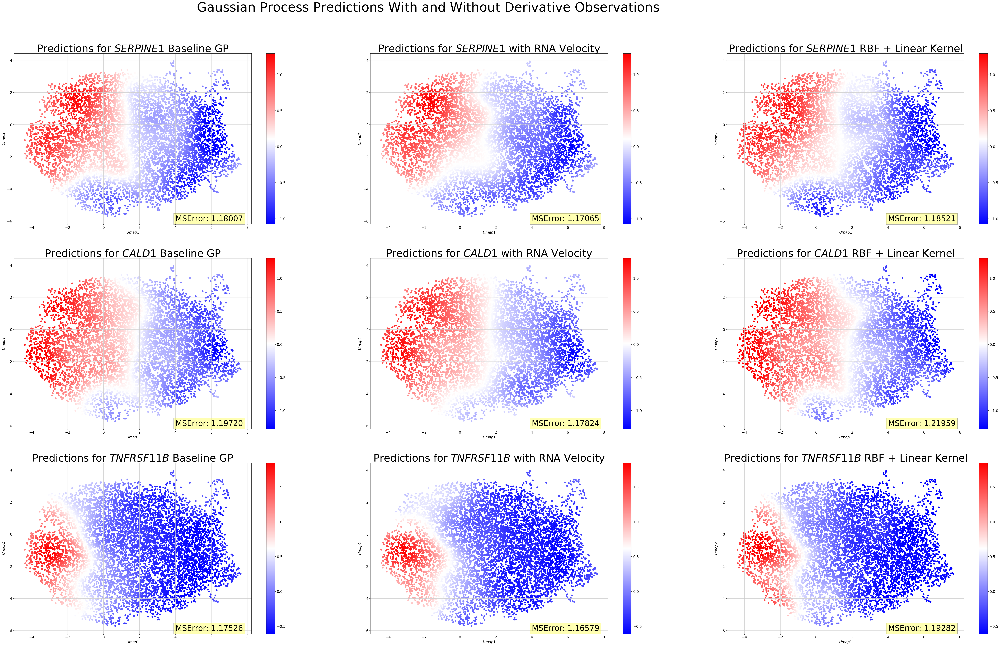

In [39]:
%matplotlib inline
fig, axs = plt.subplots(3, 3, figsize=(70,40))
dy_x1 = anndata.obsm["velocity_umap"][:, 0]
dy_x2 = anndata.obsm["velocity_umap"][:, 1]
X = anndata.obsm["X_umap"][:, :2]

for i, gene in enumerate(['SERPINE1', 'CALD1', 'TNFRSF11B']):

    y = anndata.X[:, genes[gene]].reshape(-1)
    gp.fit(X, y.reshape(-1, 1), sample_ratio=0.4)
    pred = gp.predict(X)
    gp_error = loss(y, pred)
    
    Y = np.hstack((y.reshape(-1), dy_x1, dy_x2))
    gp_do.fit(X, Y.reshape(-1, 1), sample_ratio=0.2)
    pred_do = gp_do.predict(X)
    gp_do_error = loss(y, pred_do)

    gp_combined.fit(X, y.reshape(-1, 1), sample_ratio=0.4)
    pred_combined = gp_combined.predict(X)
    gp_combined_error = loss(y, pred_combined)
    
    _min, _max = min(pred_do), max(pred_do)

    p = axs[i][0].scatter(X[:, 0], X[:, 1],  c=pred.reshape(-1), vmin=_min, vmax=_max, cmap='bwr')
    axs[i][0].text(4, -6, 'MSError: {:.5f}'.format(gp_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    axs[i][0].set_xlabel('$Umap1$')
    axs[i][0].set_ylabel('$Umap2$')
    axs[i][0].set_title("Predictions for ${gene}$ Baseline GP".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][0])

    p = axs[i][1].scatter(X[:, 0], X[:, 1],  c=pred_do.reshape(-1), vmin=_min, vmax=_max, cmap='bwr')
    axs[i][1].text(4, -6, 'MSError: {:.5f}'.format(gp_do_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    axs[i][1].set_xlabel('$Umap1$')
    axs[i][1].set_ylabel('$Umap2$')
    axs[i][1].set_title("Predictions for ${gene}$ with RNA Velocity".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][1])
    

    p = axs[i][2].scatter(X[:, 0], X[:, 1],  c=pred_combined.reshape(-1), vmin=_min, vmax=_max, cmap='bwr')
    axs[i][2].text(4, -6, 'MSError: {:.5f}'.format(gp_combined_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    axs[i][2].set_xlabel('$Umap1$')
    axs[i][2].set_ylabel('$Umap2$')
    axs[i][2].set_title("Predictions for ${gene}$ RBF + Linear Kernel".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][2])
    
#     scv.pl.velocity_embedding_grid(anndata, density = 0.4, basis='X_umap', color=gene, color_map="bwr",
#                                    size=300, alpha=0.3, arrow_length=3, arrow_size=2.3, colorbar=True,
#                                    show=False, ax=axs[i][3],
#                                    title="Actual values for ${gene}$ with RNA Velocity".format(gene=gene),
#                                    fontsize=20)
    
fig.suptitle("Gaussian Process Predictions With and Without Derivative Observations",  fontsize=50)   
fig.savefig("cardio_vascular_treated_top_3_smoothest_genes_3_models.png", transparent=False)

# Analyse Genes Rankings For Each Model

In [40]:
genes = {key:idx for idx, key in enumerate(list(zip(*sorted(list(lh.items()), key=lambda x:x[1], reverse=True)))[0][:50])}
genes_do = {key:idx for idx, key in enumerate(list(zip(*sorted(list(lh_do.items()), key=lambda x:x[1], reverse=True)))[0])}
genes_combined = {key:idx for idx, key in enumerate(list(zip(*sorted(list(lh_combined.items()), key=lambda x:x[1], reverse=True)))[0])}

In [41]:
pos = {}
for key in genes.keys():
    pos[key] = genes[key] - genes_do[key]
    
print("GP vs GP + RNA Velocity".center(100))
print()
print("*********************************************************************************************".center(100))
print()
print("------------------------------------  UP  ------------------------------------\n\n", [(gene, p) for gene, p in pos.items() if p > 0])
print()
print("------------------------------------  DOWN  ------------------------------------\n\n", [(gene, p) for gene, p in pos.items() if p < 0])
print()
print("------------------------------------ UNCGANGED  ------------------------------------\n\n", [gene for gene, p in pos.items() if p == 0])

                                      GP vs GP + RNA Velocity                                       

   *********************************************************************************************    

------------------------------------  UP  ------------------------------------

 [('SERPINE1', 1), ('DDAH1', 3), ('FGF2', 3), ('DLC1', 1), ('FST', 4), ('ITGBL1', 1), ('LMO7', 3), ('CRIM1', 2), ('SPOCK1', 6), ('VGLL3', 12), ('FGF14', 4), ('LINC01266', 1), ('VCAN', 20), ('FRMD6', 14), ('MCC', 2), ('GPC6', 13)]

------------------------------------  DOWN  ------------------------------------

 [('TNFRSF11B', -2), ('CCDC80', -1), ('PXDC1', -2), ('WWTR1', -9), ('EXT1', -2), ('PDE1C', -3), ('GLS', -5), ('DMD', -1), ('PSD3', -13), ('PLAUR', -1), ('AFAP1', -4), ('MEST', -5), ('TPM1', -6), ('SEPT11', -2), ('CDC42', -16), ('SYNE1', -8), ('ANKRD45', -62), ('AL355607.2', -400), ('NTM', -8), ('JADE1', -35), ('SH3PXD2B', -16), ('NEK7', -18), ('KCNK2', -34), ('ANKH', -23), ('STC2', -25), ('MAMDC2-AS1

In [42]:
pos = {}
for key in genes.keys():
    pos[key] = genes[key] - genes_combined[key]
    
print("GP vs GP + Combined Kernel".center(100))
print()
print("*********************************************************************************************".center(100))
print()
print("------------------------------------  UP  ------------------------------------\n\n", [(gene, p) for gene, p in pos.items() if p > 200])
print()
print("------------------------------------  DOWN  ------------------------------------\n\n", [(gene, p) for gene, p in pos.items() if p < -200])
print()
print("------------------------------------ UNCGANGED  ------------------------------------\n\n", [gene for gene, p in pos.items() if p == 0])

                                     GP vs GP + Combined Kernel                                     

   *********************************************************************************************    

------------------------------------  UP  ------------------------------------

 []

------------------------------------  DOWN  ------------------------------------

 [('ANKRD45', -394)]

------------------------------------ UNCGANGED  ------------------------------------

 ['CALD1', 'PXDC1', 'CRIM1', 'VGLL3', 'JADE1']


## MSErrors

In [41]:
mse_errors[:500]

[89.2624576128385,
 90.25981876925823,
 88.60841458981575,
 92.60523681272086,
 88.80703431544156,
 88.15091051102006,
 87.64382388997728,
 93.45161673170071,
 86.8041734862177,
 90.55385314679745,
 91.60230605981515,
 87.994083504664,
 89.79281588606257,
 89.49249653141884,
 89.53187771179299,
 87.38948847174692,
 97.22290369766607,
 88.6885103695129,
 86.92009655585369,
 89.19850294528153,
 88.21522598237452,
 86.84403416850284,
 90.20438410875063,
 88.37503498299282,
 92.71713293278258,
 95.53909837097575,
 92.48212910737543,
 91.5189171796199,
 87.03526407580011,
 87.38841472153406,
 88.68143491092374,
 89.18117078040308,
 94.21233305601409,
 92.11165203963654,
 94.21632385653245,
 88.25539461479457,
 89.43803935443957,
 87.49518668952803,
 86.85244386609006,
 91.12358150414589,
 88.78987287879231,
 90.98713452703944,
 86.66068370780408,
 90.83573950401119,
 87.91396210956297,
 88.5184939259961,
 89.29209480830545,
 90.57774114304661,
 91.84223378625671,
 92.23458065499989,
 92.856

In [43]:
errors_do[:500]

[89.69833422817084,
 89.36311242333635,
 89.01042772087602,
 91.30277771320152,
 88.95222321545958,
 87.66348229191269,
 88.00735304895345,
 91.8684708606007,
 86.86963712735029,
 90.80365609167052,
 90.95215598054219,
 88.48723730249725,
 90.99070355540688,
 90.07235372472904,
 90.20106385476909,
 87.63780015252426,
 96.00721792061114,
 89.65042153612396,
 86.89826572254711,
 88.4157683871588,
 87.91655223969771,
 87.39667282264857,
 89.51370367484645,
 87.53479574839344,
 92.57398628002942,
 94.26700138051554,
 91.08162525087029,
 91.33455177520395,
 87.11307962730369,
 87.71767478526142,
 89.43352938803089,
 89.54518466324012,
 93.83414728220053,
 91.57400372360628,
 93.71002531461843,
 88.4897060211458,
 89.72009624637015,
 87.24628709663592,
 86.87247000659869,
 90.90757291974401,
 88.7063760455785,
 91.39234768694355,
 86.73548916714124,
 89.33693242260925,
 87.57237229960035,
 88.56301723403203,
 88.73046697499844,
 90.57211371817534,
 90.40414100311334,
 90.69081291165635,
 92.

In [44]:
errors_combined[:500]

[90.11777206554589,
 90.08556059599803,
 88.83032812526028,
 92.55212968479702,
 88.35944349064181,
 88.6791546295952,
 87.44227841335707,
 94.10899177220602,
 86.61035807597256,
 91.41231748724304,
 92.56236754584793,
 88.2453303128984,
 90.42749537865349,
 90.14038112517387,
 89.73283059727233,
 87.66870542679001,
 97.4129288722496,
 88.96723989075693,
 87.30443664149674,
 89.6668731220974,
 88.70369133033125,
 87.02642403912412,
 90.36696261270238,
 88.69426367303576,
 93.51094581448089,
 97.13763271800576,
 92.41869281893749,
 91.93071867487286,
 87.02095031261933,
 87.52054606810533,
 89.39638301827989,
 89.09130992898075,
 95.65418744074198,
 93.54647733117707,
 95.55434653062137,
 88.42756448328227,
 90.93684227715549,
 87.78825943526682,
 86.75582072184055,
 91.01701679933078,
 89.00451751588378,
 92.3269708579093,
 87.21093311145565,
 91.51090397208435,
 89.21922233461754,
 88.89918064478591,
 89.67626233131337,
 89.96738477680367,
 92.44288172138819,
 91.98870711793172,
 91.5

### Results from Mean Squared Error 

    1. GP vs GP + RNA Velocity: The value of t is -9.253104. The value of p is < .00001. 
    The result is significant at p < .05.

    2. GP vs GP + Combined Kernel: The value of t is 13.48468. The value of p is < .00001. 
    The result isignificant at p < .05.
        
    3. GP + Combined Kernel vs GP + RNA Velocity: The value of t is -15.156978. The value of p is < .00001. 
    The result is significant at p < .05.

# Analyse The Genes That Changed The Most

In [43]:
genes = {gene:i for i, gene in enumerate(list(anndata.var["velocity_genes"].index)) if anndata.var["velocity_genes"][gene]}
GENES = list(genes.keys())

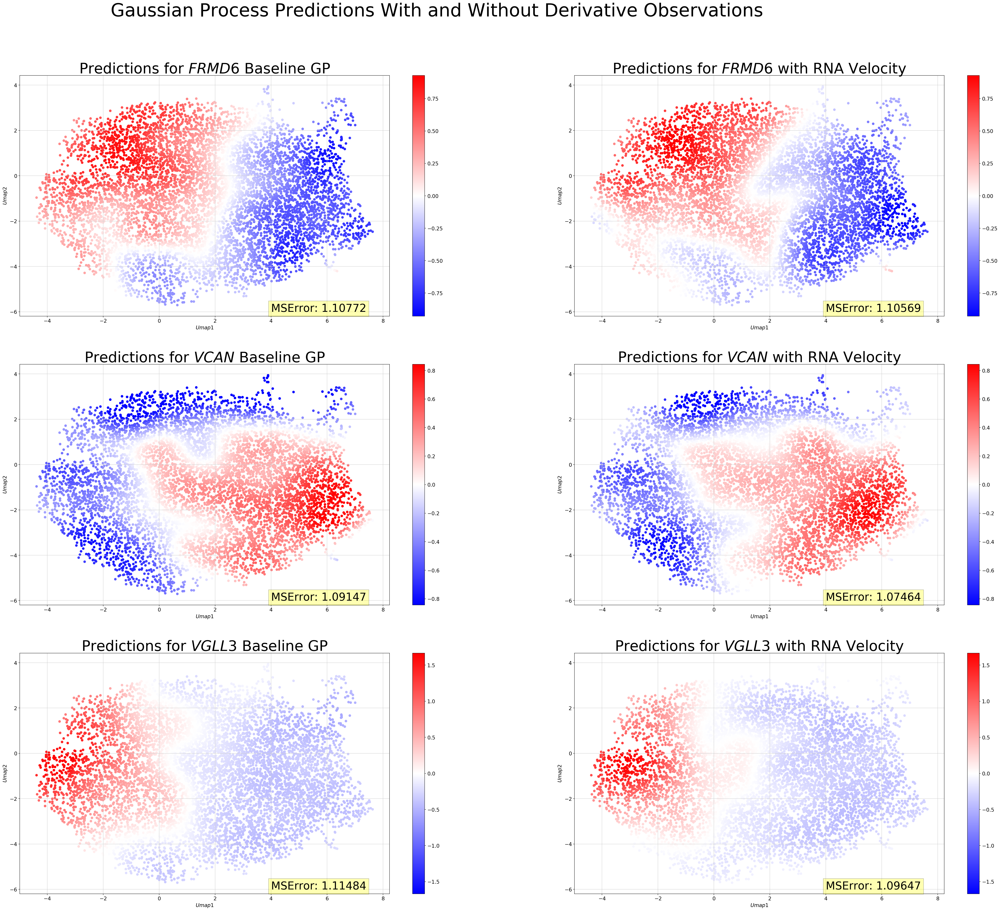

In [49]:
%matplotlib inline
fig, axs = plt.subplots(3, 2, figsize=(50,40))
dy_x1 = anndata.obsm["velocity_umap"][:, 0]
dy_x2 = anndata.obsm["velocity_umap"][:, 1]
X = anndata.obsm["X_umap"][:, :2]

for i, gene in enumerate(["FRMD6", "VCAN", "VGLL3"][:3]):

    y = anndata.X[:, genes[gene]].reshape(-1)
    gp.fit(X, y.reshape(-1, 1), sample_ratio=0.4)
    pred = gp.predict(X)
    gp_error = loss(y, pred)
    
    Y = np.hstack((y.reshape(-1), dy_x1, dy_x2))
    gp_do.fit(X, Y.reshape(-1, 1), sample_ratio=0.5)
    pred_do = gp_do.predict(X)
    gp_do_error = loss(y, pred_do)

    _min, _max = min(pred_do), max(pred_do)
    vmin, vmax = -_max, _max

    p = axs[i][0].scatter(X[:, 0], X[:, 1],  c=pred.reshape(-1), vmin=vmin, vmax=vmax, cmap='bwr')
    axs[i][0].text(4, -6, 'MSError: {:.5f}'.format(gp_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    axs[i][0].set_xlabel('$Umap1$')
    axs[i][0].set_ylabel('$Umap2$')
    axs[i][0].set_title("Predictions for ${gene}$ Baseline GP".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][0])

    p = axs[i][1].scatter(X[:, 0], X[:, 1],  c=pred_do.reshape(-1), vmin=vmin, vmax=vmax, cmap='bwr')
    axs[i][1].text(4, -6, 'MSError: {:.5f}'.format(gp_do_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    
    axs[i][1].set_xlabel('$Umap1$')
    axs[i][1].set_ylabel('$Umap2$')
    axs[i][1].set_title("Predictions for ${gene}$ with RNA Velocity".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][1])
    
    
fig.suptitle("Gaussian Process Predictions With and Without Derivative Observations",  fontsize=50)   
fig.savefig("cardio_vascular_treated_changed_genes_up.png", transparent=False)

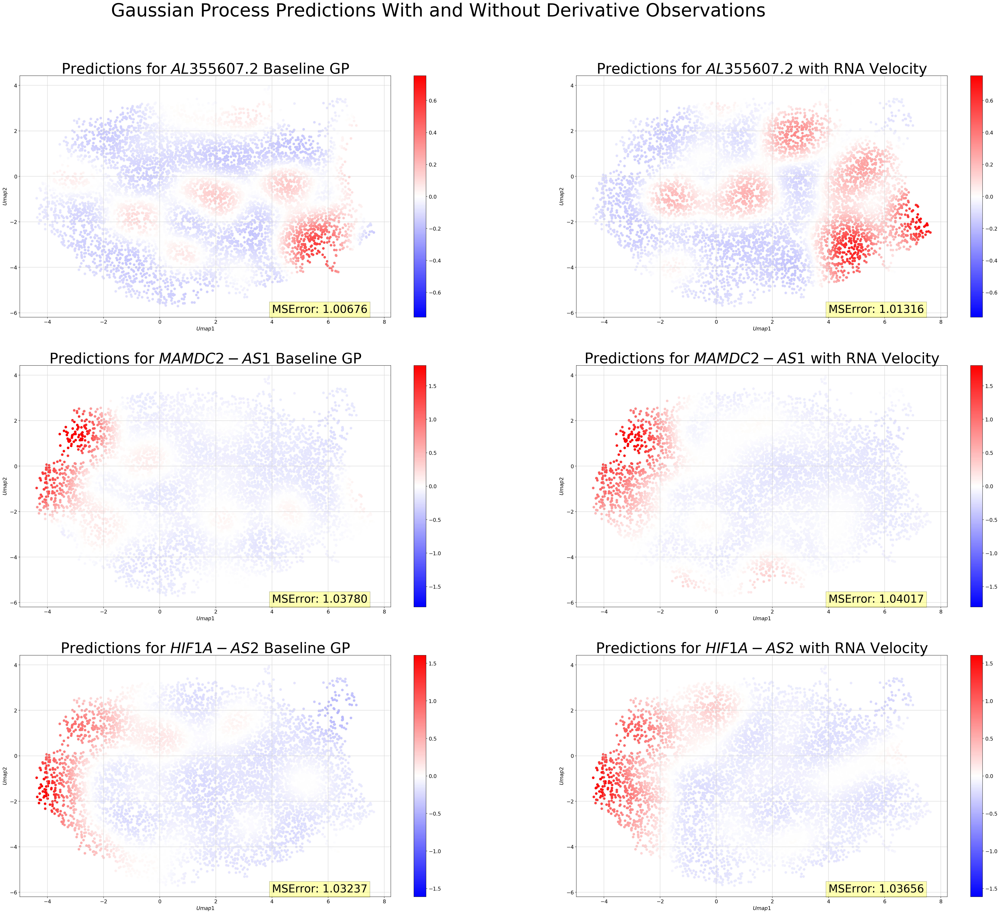

In [50]:
%matplotlib inline
fig, axs = plt.subplots(3, 2, figsize=(50,40))
dy_x1 = anndata.obsm["velocity_umap"][:, 0]
dy_x2 = anndata.obsm["velocity_umap"][:, 1]
X = anndata.obsm["X_umap"][:, :2]

for i, gene in enumerate(['AL355607.2', 'MAMDC2-AS1', 'HIF1A-AS2']):

    y = anndata.X[:, genes[gene]].reshape(-1)
    gp.fit(X, y.reshape(-1, 1), sample_ratio=0.4)
    pred = gp.predict(X)
    gp_error = loss(y, pred)
    
    Y = np.hstack((y.reshape(-1), dy_x1, dy_x2))
    gp_do.fit(X, Y.reshape(-1, 1), sample_ratio=0.2)
    pred_do = gp_do.predict(X)
    gp_do_error = loss(y, pred_do)

    _min, _max = min(pred_do), max(pred_do)
    vmin, vmax = -_max, _max

    p = axs[i][0].scatter(X[:, 0], X[:, 1],  c=pred.reshape(-1), vmin=vmin, vmax=vmax, cmap='bwr')
    axs[i][0].text(4, -6, 'MSError: {:.5f}'.format(gp_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    axs[i][0].set_xlabel('$Umap1$')
    axs[i][0].set_ylabel('$Umap2$')
    axs[i][0].set_title("Predictions for ${gene}$ Baseline GP".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][0])

    p = axs[i][1].scatter(X[:, 0], X[:, 1],  c=pred_do.reshape(-1), vmin=vmin, vmax=vmax, cmap='bwr')
    axs[i][1].text(4, -6, 'MSError: {:.5f}'.format(gp_do_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    
    axs[i][1].set_xlabel('$Umap1$')
    axs[i][1].set_ylabel('$Umap2$')
    axs[i][1].set_title("Predictions for ${gene}$ with RNA Velocity".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][1])
    
fig.suptitle("Gaussian Process Predictions With and Without Derivative Observations",  fontsize=50)   
fig.savefig("cardio_vascular_treated_changed_genes_down.png", transparent=False)

# Compare Identified Genes by Models to Highly Variable Genes

In [24]:
sc.pp.highly_variable_genes(anndata)

extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [36]:
higly_variable = [gene for gene in anndata.var["highly_variable"].index if anndata.var["highly_variable"][gene]]
all_genes = {gene:i for i, gene in enumerate(list(anndata.var["velocity_genes"].index))}

In [47]:
kernel_hv = RBFKernel(alpha=1, gamma=1)
gp_hv = GP(kernel=kernel, alpha=1e-10, derivative_observations=True, optimize=True, restarts=0)

In [48]:
error_hv = []
error_weighted_hv = []

X = anndata.obsm["X_umap"][:, :2]
dy_x1 = anndata.obsm["velocity_umap"][:, 0]
dy_x2 = anndata.obsm["velocity_umap"][:, 1]

In [49]:
#### Optimize for random gene
random_gene = np.random.choice(higly_variable)
print(random_gene)
y = anndata.X[:, all_genes[random_gene]].reshape(-1)
Y = np.hstack((y, dy_x1, dy_x2))
gp_hv.fit(X, Y.reshape(-1, 1), sample_ratio=0.2)
kernel_hv.gamma

GORAB


array(1.)

In [50]:
for gene in higly_variable:
    y = anndata.X[:, all_genes[gene]].reshape(-1)
    Y = np.hstack((y, dy_x1, dy_x2))
    gp_hv.fit(X, Y.reshape(-1, 1), sample_ratio=0.2)
    gp_hv.log_marginal_likelihood(gene, info=True)
    pred = gp_hv.predict(X)
    error_hv.append(np.sqrt(np.sum((y - pred)**2)/X.shape[0]))
    error_weighted_hv.append(loss(y, pred))

Gene: AAED1        Marginal Likelihood: [-6006.90534226]
Gene: ABCA6        Marginal Likelihood: [-6080.66272613]
Gene: ABCA8        Marginal Likelihood: [-6023.0533098]
Gene: ABHD18       Marginal Likelihood: [-6032.54185498]
Gene: ABI3BP       Marginal Likelihood: [-6016.54923473]
Gene: ABLIM1       Marginal Likelihood: [-5989.42495006]
Gene: ABTB2        Marginal Likelihood: [-6015.01940289]
Gene: AC002378.1   Marginal Likelihood: [-6056.44424377]
Gene: AC003092.1   Marginal Likelihood: [-6030.04613643]
Gene: AC004943.2   Marginal Likelihood: [-6104.15853215]
Gene: AC005280.2   Marginal Likelihood: [-6099.23436636]
Gene: AC007364.1   Marginal Likelihood: [-6014.82645465]
Gene: AC007405.3   Marginal Likelihood: [-5954.92122059]
Gene: AC007923.4   Marginal Likelihood: [-5919.40982971]
Gene: AC008667.1   Marginal Likelihood: [-5991.53171542]
Gene: AC009226.1   Marginal Likelihood: [-6072.87920084]
Gene: AC009961.1   Marginal Likelihood: [-5951.04429117]
Gene: AC011287.1   Marginal Like

Gene: BBOF1        Marginal Likelihood: [-6037.92287413]
Gene: BCKDHB       Marginal Likelihood: [-6049.15041901]
Gene: BDNF         Marginal Likelihood: [-6082.27472623]
Gene: BIN3         Marginal Likelihood: [-6041.48447306]
Gene: BLOC1S3      Marginal Likelihood: [-6061.94365761]
Gene: BLOC1S5-TXNDC5 Marginal Likelihood: [-6087.368858]
Gene: BMP2K        Marginal Likelihood: [-5985.36479175]
Gene: BMP6         Marginal Likelihood: [-6057.78014366]
Gene: BORCS5       Marginal Likelihood: [-6032.78777183]
Gene: BRWD3        Marginal Likelihood: [-5959.17141755]
Gene: BTG2         Marginal Likelihood: [-6106.46756694]
Gene: BTG3         Marginal Likelihood: [-6103.1106662]
Gene: BZW2         Marginal Likelihood: [-5982.65839097]
Gene: C10orf90     Marginal Likelihood: [-6055.98763109]
Gene: C11orf80     Marginal Likelihood: [-6085.84419183]
Gene: C11orf96     Marginal Likelihood: [-6025.73788775]
Gene: C15orf41     Marginal Likelihood: [-6033.51530925]
Gene: C19orf18     Marginal Like

Gene: EGR2         Marginal Likelihood: [-6105.6441427]
Gene: EIF1AD       Marginal Likelihood: [-6008.67440146]
Gene: EIF2AK3      Marginal Likelihood: [-6071.1259315]
Gene: EIF2B1       Marginal Likelihood: [-6011.82975677]
Gene: EIF4A3       Marginal Likelihood: [-6069.21265453]
Gene: ELP2         Marginal Likelihood: [-6037.69112052]
Gene: ELP4         Marginal Likelihood: [-6065.78041131]
Gene: EMB          Marginal Likelihood: [-6047.63416854]
Gene: EML1         Marginal Likelihood: [-5982.83999775]
Gene: EML6         Marginal Likelihood: [-6075.45285549]
Gene: EMP2         Marginal Likelihood: [-5950.390445]
Gene: EMX2OS       Marginal Likelihood: [-5990.63552158]
Gene: ENPP1        Marginal Likelihood: [-6006.60259407]
Gene: EPHA4        Marginal Likelihood: [-6034.52637695]
Gene: EPHA5        Marginal Likelihood: [-5961.70292758]
Gene: EPM2A        Marginal Likelihood: [-6054.8427234]
Gene: EPSTI1       Marginal Likelihood: [-6016.75853069]
Gene: ERCC6        Marginal Likeliho

Gene: HS3ST3B1     Marginal Likelihood: [-6052.21957503]
Gene: HSBP1L1      Marginal Likelihood: [-6035.58740372]
Gene: HSD11B1      Marginal Likelihood: [-6043.34655595]
Gene: HSP90AA1     Marginal Likelihood: [-6034.31595983]
Gene: HSPBAP1      Marginal Likelihood: [-6161.1617552]
Gene: HYDIN        Marginal Likelihood: [-6051.32645281]
Gene: ICA1L        Marginal Likelihood: [-6091.64785521]
Gene: IDH3B        Marginal Likelihood: [-6013.36049736]
Gene: IFFO1        Marginal Likelihood: [-6121.73077422]
Gene: IFT172       Marginal Likelihood: [-6044.07031913]
Gene: IFT88        Marginal Likelihood: [-6015.27569498]
Gene: IGF1         Marginal Likelihood: [-6034.4754431]
Gene: IL12A        Marginal Likelihood: [-5958.254106]
Gene: IL12RB2      Marginal Likelihood: [-6035.61147129]
Gene: IL32         Marginal Likelihood: [-5969.88760921]
Gene: IL33         Marginal Likelihood: [-6001.39185689]
Gene: IMPA1        Marginal Likelihood: [-5974.91994139]
Gene: ING4         Marginal Likelih

Gene: MEF2C        Marginal Likelihood: [-6000.0541125]
Gene: MEF2D        Marginal Likelihood: [-6030.58956276]
Gene: MEIS1        Marginal Likelihood: [-6019.04337876]
Gene: MET          Marginal Likelihood: [-6156.14146988]
Gene: MFSD2B       Marginal Likelihood: [-6009.22160939]
Gene: MFSD8        Marginal Likelihood: [-6011.96523412]
Gene: MGLL         Marginal Likelihood: [-6052.69394514]
Gene: MICAL3       Marginal Likelihood: [-5999.6882577]
Gene: MID1         Marginal Likelihood: [-6071.32433361]
Gene: MINK1        Marginal Likelihood: [-5935.66721873]
Gene: MIPEP        Marginal Likelihood: [-6065.55599254]
Gene: MIR646HG     Marginal Likelihood: [-6051.68090422]
Gene: MIS18BP1     Marginal Likelihood: [-6027.05701248]
Gene: MKL2         Marginal Likelihood: [-6067.47755095]
Gene: MLLT3        Marginal Likelihood: [-5985.6545758]
Gene: MMP1         Marginal Likelihood: [-5919.52140899]
Gene: MMP19        Marginal Likelihood: [-5990.78496287]
Gene: MMS22L       Marginal Likeli

Gene: PIM1         Marginal Likelihood: [-6058.31401143]
Gene: PITPNM2      Marginal Likelihood: [-5975.6448102]
Gene: PIWIL2       Marginal Likelihood: [-6020.14311998]
Gene: PKIA         Marginal Likelihood: [-6022.43731863]
Gene: PKNOX1       Marginal Likelihood: [-6058.0194681]
Gene: PLA2R1       Marginal Likelihood: [-6016.55825557]
Gene: PLAGL1       Marginal Likelihood: [-6054.88325382]
Gene: PLAT         Marginal Likelihood: [-5990.31365202]
Gene: PLAU         Marginal Likelihood: [-6013.56276462]
Gene: PLCL1        Marginal Likelihood: [-6002.6592648]
Gene: PLEK2        Marginal Likelihood: [-6060.72556643]
Gene: PLEKHA6      Marginal Likelihood: [-5998.60915366]
Gene: PLEKHF1      Marginal Likelihood: [-6005.11500827]
Gene: PLEKHG1      Marginal Likelihood: [-6081.60397098]
Gene: PLEKHG6      Marginal Likelihood: [-6014.42013982]
Gene: PLEKHH2      Marginal Likelihood: [-6085.09550226]
Gene: PLEKHM3      Marginal Likelihood: [-6056.36756259]
Gene: PLPP3        Marginal Likeli

Gene: SINHCAF      Marginal Likelihood: [-6014.50317441]
Gene: SKAP2        Marginal Likelihood: [-6010.01689229]
Gene: SLC12A6      Marginal Likelihood: [-6088.86363754]
Gene: SLC12A8      Marginal Likelihood: [-5980.04976282]
Gene: SLC15A1      Marginal Likelihood: [-6066.0551979]
Gene: SLC16A2      Marginal Likelihood: [-6057.5240209]
Gene: SLC16A4      Marginal Likelihood: [-6038.07570257]
Gene: SLC18A2      Marginal Likelihood: [-6046.53678912]
Gene: SLC22A23     Marginal Likelihood: [-6003.87778791]
Gene: SLC23A2      Marginal Likelihood: [-6064.0539009]
Gene: SLC24A1      Marginal Likelihood: [-5954.71929701]
Gene: SLC25A12     Marginal Likelihood: [-6014.65270701]
Gene: SLC25A16     Marginal Likelihood: [-6037.62805833]
Gene: SLC25A4      Marginal Likelihood: [-6020.88974658]
Gene: SLC25A45     Marginal Likelihood: [-6132.49370522]
Gene: SLC29A3      Marginal Likelihood: [-6095.60248099]
Gene: SLC2A13      Marginal Likelihood: [-5998.38070258]
Gene: SLC35E3      Marginal Likeli

Gene: UNKL         Marginal Likelihood: [-6069.87104458]
Gene: UQCC1        Marginal Likelihood: [-6051.49930754]
Gene: USP3         Marginal Likelihood: [-5990.35997838]
Gene: USP31        Marginal Likelihood: [-6021.92219]
Gene: USP36        Marginal Likelihood: [-6046.45527943]
Gene: USP37        Marginal Likelihood: [-6060.66703856]
Gene: USP42        Marginal Likelihood: [-6001.87550137]
Gene: USP49        Marginal Likelihood: [-6054.0866829]
Gene: USPL1        Marginal Likelihood: [-5996.53415073]
Gene: VARS         Marginal Likelihood: [-6101.92320795]
Gene: VAV2         Marginal Likelihood: [-6075.18739675]
Gene: VGLL3        Marginal Likelihood: [-6055.961143]
Gene: VIM-AS1      Marginal Likelihood: [-6009.6276459]
Gene: VPS37B       Marginal Likelihood: [-6009.74686621]
Gene: VPS50        Marginal Likelihood: [-5938.01692491]
Gene: VPS51        Marginal Likelihood: [-6034.66960491]
Gene: VSIG10       Marginal Likelihood: [-6000.79748657]
Gene: WARS         Marginal Likelihood

In [51]:
lh_hv = gp_hv.get_all_likelihoods()
top_hv = list(zip(*sorted(list(lh_hv.items()), key=lambda x:x[1], reverse=True)))[0]
last_hv = top_hv[::-1]
top_hv[:10]

('TMEM131L',
 'LINC02516',
 'Z94721.1',
 'NR3C2',
 'CDH23',
 'PXDNL',
 'SMARCE1',
 'CACNG7',
 'PRDM16',
 'FUT10')

In [52]:
last_hv[:10]

('CRABP2',
 'UNC79',
 'HIRIP3',
 'NR4A3',
 'COQ8B',
 'IPPK',
 'GNB3',
 'PTCH2',
 'HSPBAP1',
 'PARP9')

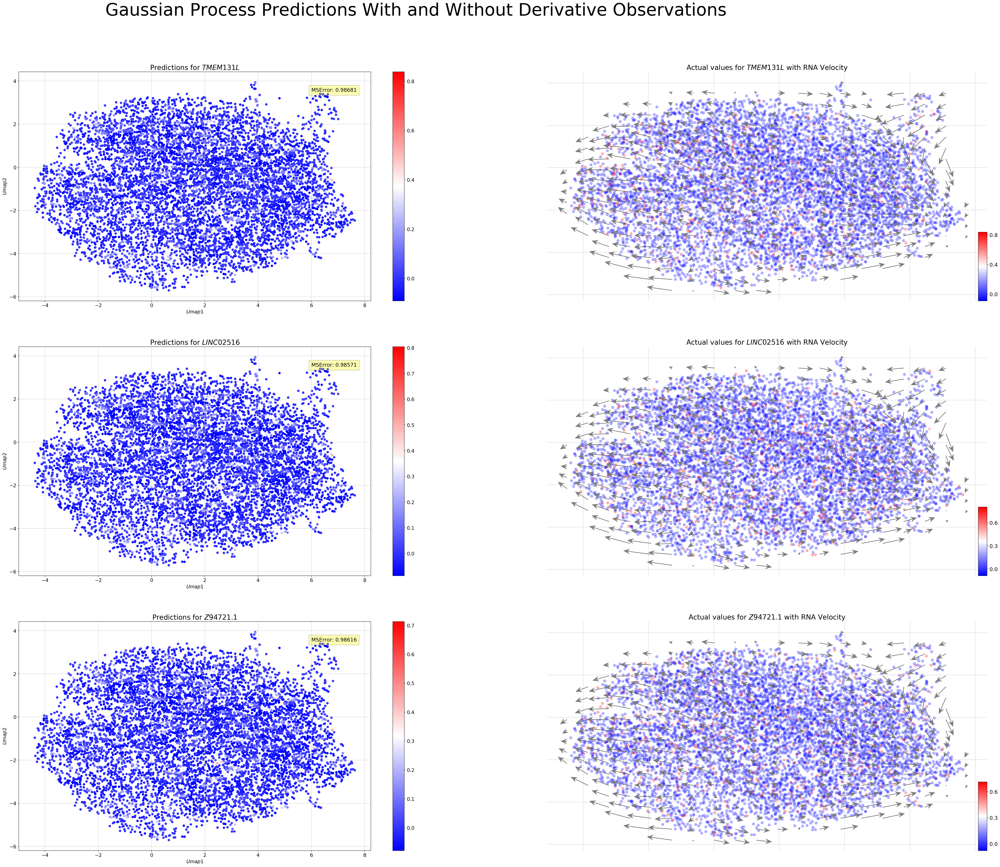

In [54]:
%matplotlib inline
fig, axs = plt.subplots(3,2, figsize=(50,40))
X = anndata.obsm["X_umap"][:, :2]

for i, gene in enumerate(top_hv[:3]):

    y = anndata.X[:, all_genes[gene]].reshape(-1)
    Y = np.hstack((y, dy_x1, dy_x2))
    gp_hv.fit(X, Y.reshape(-1, 1), sample_ratio=0.2)
    pred_hv = gp_hv.predict(X)
    gp_hv_error = loss(y, pred_hv.reshape(-1))
    
    p = axs[i][0].scatter(X[:, 0], X[:, 1],  c=pred.reshape(-1), cmap='bwr', vmin=np.min(pred_hv), vmax=np.max(pred_hv))
    axs[i][0].text(6, 3.5, 'MSError: {:.5f}'.format(gp_hv_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=15)
    axs[i][0].set_xlabel('$Umap1$')
    axs[i][0].set_ylabel('$Umap2$')
    axs[i][0].set_title("Predictions for ${gene}$".format(gene=gene), fontsize=20)
    fig.colorbar(p, ax=axs[i][0])

    scv.pl.velocity_embedding_grid(anndata, density = 0.4, basis='X_umap', color=gene, color_map="bwr",
                                   size=300, alpha=0.3, arrow_length=3, arrow_size=2.3, colorbar=True,
                                   show=False, ax=axs[i][1], vmin=np.min(pred_hv), vmax=np.max(pred_hv),
                                   title="Actual values for ${gene}$ with RNA Velocity".format(gene=gene),
                                   fontsize=20)
    
fig.suptitle("Gaussian Process Predictions With and Without Derivative Observations",  fontsize=50)   
fig.savefig("cardio_vascular_treated_top_3_smoothest_highly_variable_genes.png", transparent=False)